<a href="https://colab.research.google.com/github/adihebbalae/adihebbalae-MusicRecommenders/blob/main/Section4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys

# new dependencies
!pip --disable-pip-version-check install requests==2.27.1
!pip --disable-pip-version-check install urllib3
!pip --disable-pip-version-check install spotipy --upgrade
!pip --disable-pip-version-check  install traces

import spotipy
import requests
from spotipy.oauth2 import SpotifyClientCredentials
import traces

# do not change these codes
client_credentials_manager = SpotifyClientCredentials('e316c18604cb42399f3b679791362112','4bd95a0d37d145998cfdcaf2a68579d7')
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

# machine learning models
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split

# audio analysis
import librosa
import librosa.display
!pip install audio2numpy
!apt-get install ffmpeg
import audio2numpy
import IPython.display as ipd
from IPython.display import YouTubeVideo

#warning supression
import warnings
warnings.filterwarnings("ignore")

# helper function to plot a timbre timecourse
def plot_timbre(df, song_id, timbre_col):
    col = f'timbre_{timbre_col}'
    plt.figure()
    plt.plot([i*.5 for i in range(len(df[col][song_id]))], df[col][song_id])
    plt.xlabel('time/seconds')
    plt.ylabel('timbre component weight')

# timbre timecourses
# data_url = 'https://drive.google.com/uc?id=1jwG1B98Uq5phurfGmdZg8w2BCJdth6Io'
!wget -O ./spotify_data_timbre.csv = 'https://storage.googleapis.com/inspirit-ai-data-bucket-1/Data/AI%20Scholars/Sessions%206%20-%2010%20(Projects)/Project%20-%20Music%20Recommendation/spotify_data_timbre.csv'
data_path = './spotify_data_timbre.csv'

# chirp file
# chirp_url = 'https://drive.google.com/uc?id=1iX6wV0cSGIVM0nTItTSUlUehhKCILymB'
!wget -O ./chirp.wav = 'https://storage.googleapis.com/inspirit-ai-data-bucket-1/Data/AI%20Scholars/Sessions%206%20-%2010%20(Projects)/Project%20-%20Music%20Recommendation/chirp.wav'
chirp_path = './chirp.wav'

# two wav files
# wav1_url = 'https://drive.google.com/uc?id=14qA48pPVJKU4KlP8YwqTpDo7WEewjXwf'
!wget -O ./sample1.wav = 'https://storage.googleapis.com/inspirit-ai-data-bucket-1/Data/AI%20Scholars/Sessions%206%20-%2010%20(Projects)/Project%20-%20Music%20Recommendation/track_3504.wav'
wav1_path = './sample1.wav'

# wav2_url = 'https://drive.google.com/uc?id=12XIWhMCAiabzGqXQhN2wB9o5p6MFR4Y0'
!wget -O ./sample2.wav = 'https://storage.googleapis.com/inspirit-ai-data-bucket-1/Data/AI%20Scholars/Sessions%206%20-%2010%20(Projects)/Project%20-%20Music%20Recommendation/track_3642.wav'
wav2_path = './sample2.wav'

# Check that the data downloaded by running this cell! It'll have more columns than usual.
data = pd.read_csv(data_path)
data.rename(columns={'Unnamed: 0':'orig_index'},inplace=True)
data.drop(columns=['index'],inplace=True)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.1/50.1 kB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.2/144.2 kB 10.7 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 2.2.3
    Uninstalling urllib3-2.2.3:
      Successfully uninstalled urllib3-2.2.3
  Attempting uninstall: charset-normalizer
    Found existing installation: charset-normalizer 3.4.0
    Uninstalling charset-normalizer-3.4.0:
      Successfully uninstalled charset-normalizer-3.4.0
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Uninstalling requests-2.32.3:
      Successfully uninstalled requests-2.32.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests==2.32.3, but you have requests

/usr/local/lib/python3.10/dist-packages/requests/__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.20) or chardet (5.2.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


  Preparing metadata (setup.py) ... done
  Created wheel for ffmpeg: filename=ffmpeg-1.4-py3-none-any.whl size=6082 sha256=ac99bf3404e0f298a445b40e936075663dd67fa875c5d6eed97294ad51070575
  Stored in directory: /root/.cache/pip/wheels/8e/7a/69/cd6aeb83b126a7f04cbe7c9d929028dc52a6e7d525ff56003a
Successfully built ffmpeg
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.
--2024-12-22 01:20:04--  http://=/
Resolving = (=)... failed: Name or service not known.
wget: unable to resolve host address ‘=’
--2024-12-22 01:20:04--  https://storage.googleapis.com/inspirit-ai-data-bucket-1/Data/AI%20Scholars/Sessions%206%20-%2010%20(Projects)/Project%20-%20Music%20Recommendation/spotify_data_timbre.csv
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.196.207, 74.125.141.207, 74.125.139.207, ...
Connecting to

In [ ]:
ipd.Audio(wav1_path) # this uses a library called IPython.display

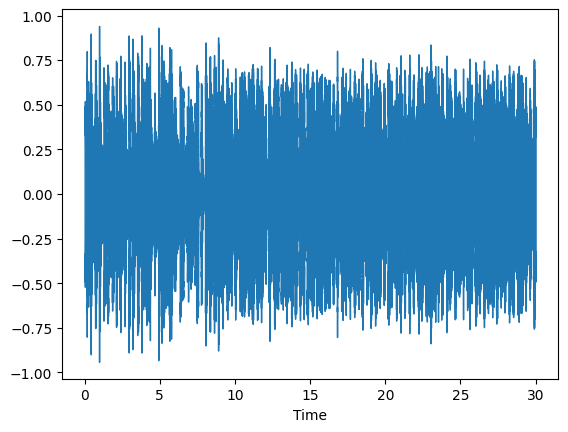

In [ ]:
# load in the audio file
audio, fs = librosa.load(wav1_path)
librosa.display.waveshow(audio)
plt.show()

In [ ]:
ipd.Audio(chirp_path)

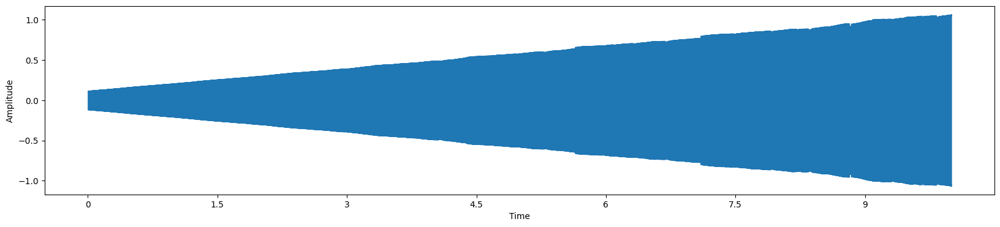

In [ ]:
# load in the audio file
audio1, fs1 = librosa.load(chirp_path)
plt.figure(figsize=(20,4))
librosa.display.waveshow(audio1)
plt.ylabel("Amplitude")
plt.show()

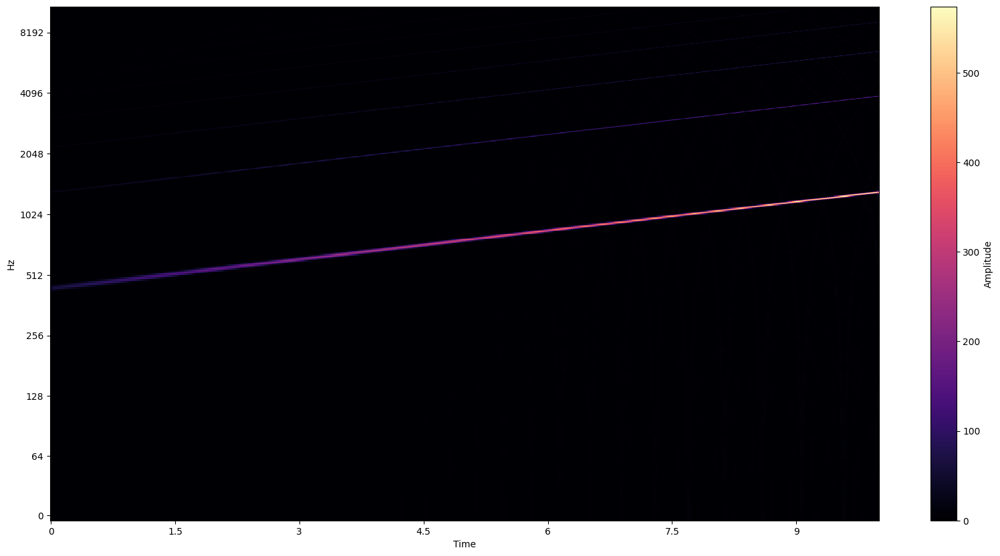

In [ ]:
# perform short-time fourier transform (this makes the raw spectrogram)
D = librosa.stft(audio1)

# display the spectrogram
fig, ax = plt.subplots()
img = librosa.display.specshow(D, ax=ax, x_axis='time', y_axis='log')
fig.colorbar(img, ax=ax, label="Amplitude")
fig.set_size_inches(20,10)

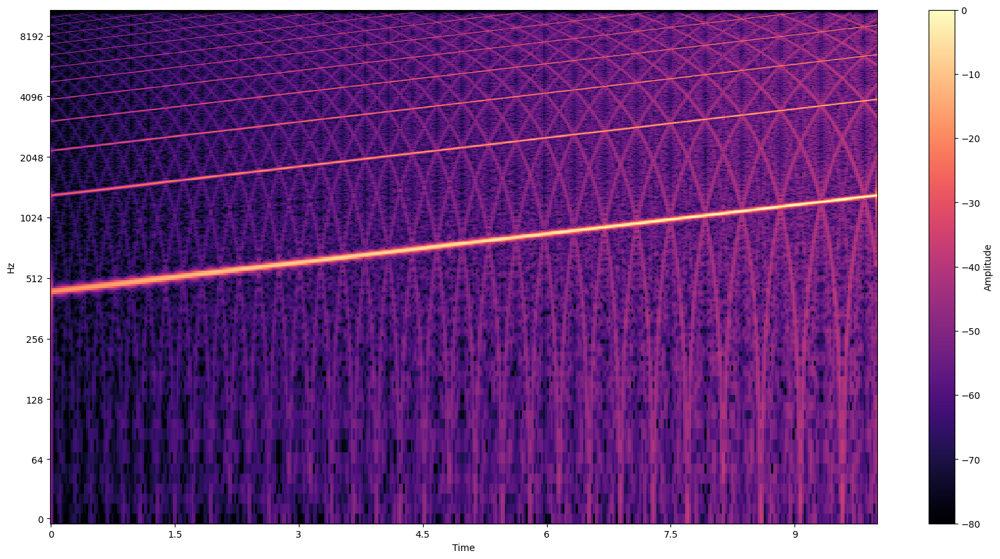

In [ ]:
# perform short-time fourier transform (this makes the raw spectrogram)
D = librosa.stft(audio1)

# convert the amplitude to decibel scale
# specgram_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
specgram_db = librosa.amplitude_to_db(np.abs(D), ref = np.max(D))

# display the spectrogram
fig, ax = plt.subplots()
img = librosa.display.specshow(specgram_db, ax=ax, x_axis='time', y_axis='log')
fig.colorbar(img, ax=ax, label="Amplitude")
fig.set_size_inches(20,10)

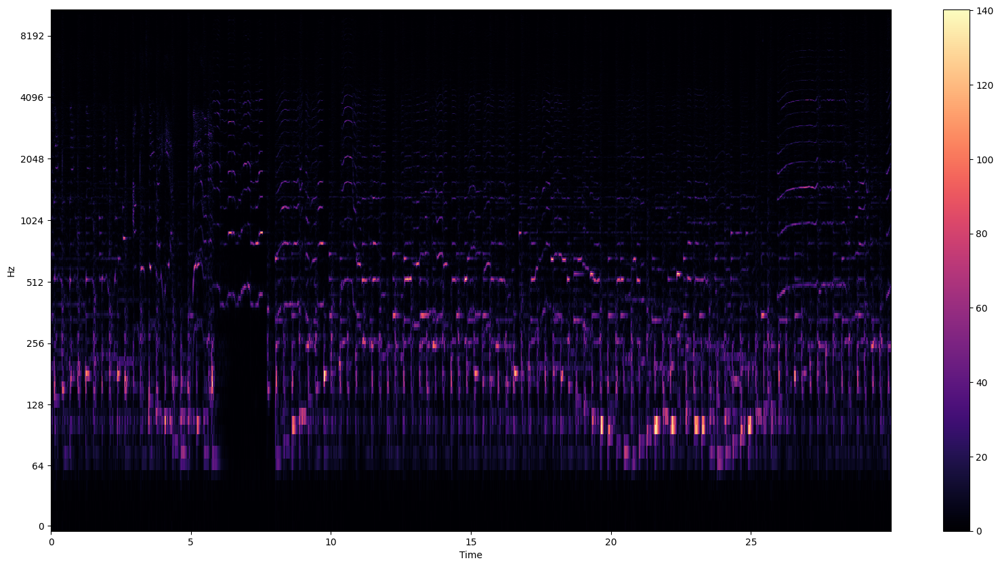

In [ ]:
# perform short-time fourier transform (this makes the raw spectrogram)
D = librosa.stft(audio)

# display the spectrogram
fig, ax = plt.subplots()
img = librosa.display.specshow(D, ax=ax, x_axis='time', y_axis='log')
fig.colorbar(img, ax=ax)
fig.set_size_inches(20,10)

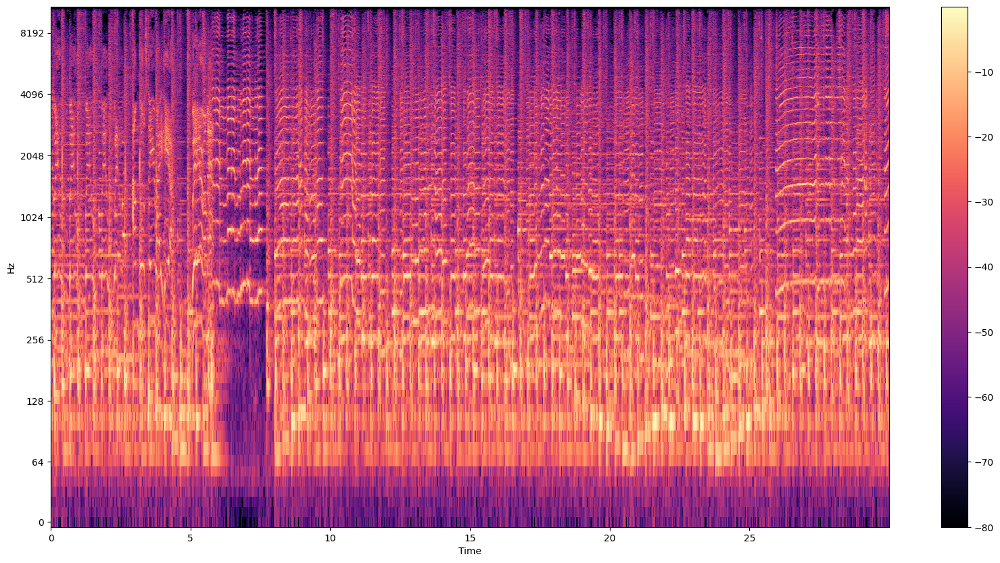

In [ ]:
# perform short-time fourier transform (this makes the raw spectrogram)
D = librosa.stft(audio)

# convert the amplitude to decibel scale (to make everything easier to see)
specgram_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

# display the spectrogram
fig, ax = plt.subplots()
img = librosa.display.specshow(specgram_db, ax=ax, x_axis='time', y_axis='log')
fig.colorbar(img, ax=ax)
fig.set_size_inches(20,10)

In [ ]:
ipd.Audio(wav2_path)

In [ ]:
### YOUR ANSWER HERE


In [ ]:
### YOUR ANSWER HERE
#

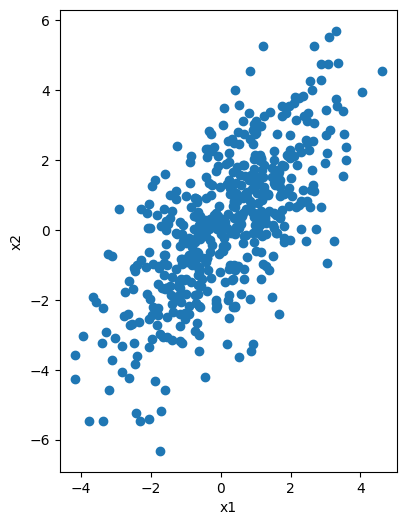

In [2]:
rng = np.random.RandomState(0)
n_samples = 500
cov = [[3, 3],
       [2, 4]]
X = rng.multivariate_normal(mean=[0, 0], cov=cov, size=n_samples)
plt.figure(figsize=(10,6))
plt.scatter(X[:,0],X[:,1])
plt.gca().set(aspect='equal',xlabel='x1',ylabel='x2')
plt.show()

In [ ]:
# run PCA
pca = PCA().fit(X)
pca

In [ ]:
plt.figure(figsize=(10,6))
plt.scatter(X[:,0],X[:,1])
for i, (comp, var) in enumerate(zip(pca.components_, pca.explained_variance_)): # this line of code means: get the actual PC vector and the amount of variance it explains
    comp = comp * var  # scale component by its variance explanation power
    print((comp[0]**2 + comp[1]**2)**(0.5))
    # then plot it as a line on top of the data
    plt.plot([0, comp[0]], [0, comp[1]], label=f"component {i}", linewidth=5,
             color=f"C{i + 2}")
plt.gca().set(xlabel='x1', ylabel='x2',aspect='equal')
plt.legend()
plt.show()

In [ ]:
X_new = PCA().fit_transform(X)

# plot
plt.figure(figsize=(6,6))
plt.scatter(X_new[:,0],X_new[:,1])
plt.plot([0,5.77],[0,0],color="C2",linewidth=5)
plt.plot([0,0],[0,0.98],color="C3",linewidth=5)
plt.gca().set(xlabel='pc1',ylabel='pc2',aspect='equal')
plt.show()

In [ ]:
print(f'Number of frequency bins: {specgram_db.shape[0]}')

In [ ]:
### YOUR CODE HERE
pca_specgram = None # change this!

In [ ]:
print(f'number of components needed for 90% variance: {pca_specgram.n_components_}')

In [ ]:
# pc plotting function
def plot_pc(pc_idx):
    pc_fig, pc_ax = plt.subplots()
    pc_ax = sns.heatmap([pca_specgram.components_[pc_idx]])
    pc_fig.set_size_inches(10,2)
    pc_ax.set_xlabel('frequency bin index')
    pc_ax.set_yticklabels('')
    pc_ax.set_title(f'PC{pc_idx+1}')
    plt.show()

### YOUR CODE HERE (for loop here)

### END CODE

In [ ]:
mu = np.mean(specgram_db.T, axis=0)
specgram_db_pc = np.matmul(pca_specgram.transform(specgram_db.T), pca_specgram.components_)
specgram_db_pc = specgram_db_pc + mu
specgram_db_pc = specgram_db_pc.T

fig, ax = plt.subplots()
img = librosa.display.specshow(specgram_db_pc, ax=ax, x_axis='time', y_axis='log')
fig.colorbar(img, ax=ax)
fig.set_size_inches(20,10)